Library Importing.

In [ ]:
!pip install pafy youtube-dl moviepy

# We use this to take videos from the youtube.

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 38.6 MB/s eta 0:00:00


In [ ]:
import os
import pafy
# It is use to download youtube content.
import cv2
import math
import random
import numpy as np
import datetime as dt
import tensorflow as tf
from collections import deque
import matplotlib.pyplot as plt
%matplotlib inline
from moviepy.editor import *
from sklearn.model_selection import train_test_split
# Spliting in train and test
from tensorflow.keras.layers import *
from tensorflow.keras.models import Sequential
# It is to start the layers.
from tensorflow.keras.utils import to_categorical
# It covert the column into the onehotencoding.
from tensorflow.keras.callbacks import EarlyStopping
# To stop it the model epochs at the best epoch.
from tensorflow.keras.utils import plot_model
# To plot the model visually

  if event.key is 'enter':



In [ ]:

seed_constant = 27
np.random.seed(seed_constant)
random.seed(seed_constant)
tf.random.set_seed(seed_constant)

In [ ]:
# %%capture
# It hides the output of this cell.

!wget --no-check-certificate https://www.crcv.ucf.edu/data/UCF50.rar
# Download UCF50 Dataset.

!unrar x UCF50.rar
# Extract the Dataset

Streaming output truncated to the last 5000 lines.
Extracting  UCF50/HorseRace/v_HorseRace_g16_c03.avi                       23%  OK 
Extracting  UCF50/HorseRace/v_HorseRace_g16_c04.avi                       23%  OK 
Extracting  UCF50/HorseRace/v_HorseRace_g16_c05.avi                       23%  OK 
Extracting  UCF50/HorseRace/v_HorseRace_g17_c01.avi                       23%  OK 
Extracting  UCF50/HorseRace/v_HorseRace_g17_c02.avi                       23%  OK 
Extracting  UCF50/HorseRace/v_HorseRace_g17_c03.avi                       23%  OK 
Extracting  UCF50/HorseRace/v_HorseRace_g17_c04.avi                       23%  OK 
Extracting  UCF50/HorseRace/v_HorseRace_g17_c05.avi                       23%  OK 
Extracting  UCF50/HorseRace/v_HorseRace_g18_c01.avi                       23%  OK 
Extracting  UCF50/HorseRace/v_HorseRace_g18_c02.avi                       23%  OK 
Extracting  UCF50/HorseRace/v

For visualization. we will pick 20 random categories from the dataset and a random video from each selected category and will visualize the
first frame of the selected videos with their associated labels written. This way we'll be able to visualize a subset ( 20 random videos ) of the
dataset.

In [ ]:
plt.figure(figsize = (20, 20))
# Setting plot size

all_classes_names = os.listdir('UCF50')
# Getting all the classes names.

print(all_classes_names)
print(len(all_classes_names))

['BenchPress', 'Rowing', 'CleanAndJerk', 'MilitaryParade', 'BaseballPitch', 'Lunges', 'GolfSwing', 'TrampolineJumping', 'JavelinThrow', 'Skiing', 'TennisSwing', 'Skijet', 'Billiards', 'Diving', 'PlayingPiano', 'JumpRope', 'PushUps', 'PlayingViolin', 'PullUps', 'Mixing', 'JugglingBalls', 'SkateBoarding', 'BreastStroke', 'HulaHoop', 'Biking', 'HighJump', 'Fencing', 'PlayingTabla', 'VolleyballSpiking', 'PlayingGuitar', 'ThrowDiscus', 'Punch', 'RockClimbingIndoor', 'SoccerJuggling', 'JumpingJack', 'WalkingWithDog', 'Drumming', 'HorseRace', 'HorseRiding', 'RopeClimbing', 'Nunchucks', 'Kayaking', 'Basketball', 'PommelHorse', 'YoYo', 'PizzaTossing', 'PoleVault', 'TaiChi', 'Swing', 'SalsaSpin']
50


<Figure size 2000x2000 with 0 Axes>

In [ ]:
random_range = random.sample(range(len(all_classes_names)), 20)
# Generate 20 random value list out of 50.

print(random_range)

[41, 30, 44, 17, 18, 12, 4, 43, 16, 34, 21, 49, 23, 25, 11, 15, 40, 31, 42, 37]


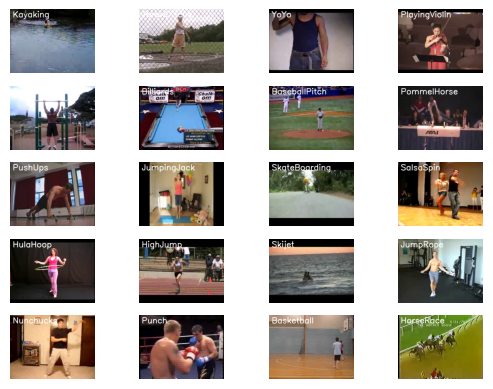

In [ ]:
# Eterating through all generated random values.
for counter, random_index in enumerate(random_range, 1):
  # print(counter, random_index)
  # Counter have index number and random_index have random 20 number from 50
  selected_class_Name = all_classes_names[random_index]

  video_files_names_list = os.listdir(f"UCF50/{selected_class_Name}")
  # print(video_files_names_list)
  # It gives the list of all the video files from randomly selected class.

  selected_video_file_name = random.choice(video_files_names_list)
  # print(selected_video_file_name)
  # It selecting the random video from the retrived list from random class.

  video_reader = cv2.VideoCapture(f"UCF50/{selected_class_Name}/{selected_video_file_name}")
  # print(video_reader)
  # It initialize the VideoCapture object to read the video file

  _, bgr_frame = video_reader.read()
  # print(_, bgr_frame)
  # Reading the 1st frame of the video file

  video_reader.release()
  # releas() we use to break the connection, close the file once work done.

  rgb_frame = cv2.cvtColor(bgr_frame, cv2.COLOR_BGR2RGB)
  # print(rgb_frame)
  # Converting frame from BGR to RGB.
  # cv2 suitable for BGR hence start with BGR then convert in RGB for libraries.

  cv2.putText(rgb_frame, selected_class_Name, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)
  # cv2.putText(image,       text,             position,          font,        font_scale, color, thickness)
  # (255, 255, 255) represents white.
  # Write class text or name on the video frame.

  plt.subplot(5, 4, counter);
  plt.imshow(rgb_frame);
  plt.axis('off');



Preprocess the Dataset :
Next, we will perform some preprocessing on the dataset. First, we will read the video files from the dataset and resize the frames of the videos to a fixed width and height, to reduce the computations and normalized the data to range [0-1] by dividing the pixel values with 255, which makes convergence faster while training the network.
But first, let's initialize some constants.

In [ ]:
IMAGE_HEIGHT, IMAGE_WIDTH = 64, 64
# Fixing the size of the each video frame. ( I will help us computaionaly )

SEQUENCE_LENGTH = 20
# Deciding how many frames we are going to give to the model from the video.
# Less number selected so good for computation.

DATASET_DIR = "UCF50"
# Specifying directory of UCF50 dataset.

CLASSES_LIST = ["TaiChi", "Rowing", "WalkingWithDog", "PushUps"]
# We are only selecting this classes from our randomly selected 20.
# We are training only with this classes.
# Same Reason, Computationally good.

# We can increase all details but selecting less otherwise it will be computaionaly expensive.


Create a Function to Extract, Resize & Normalize Frames.

We will create a function **frames_extraction()** that will create a list containing the resized and normalized frames of a video whose path is
passed to it as an argument. The function will read the video file frame by frame, although not all frames are added to the list as we will only need an evenly distributed sequence length of frames.

In [ ]:
def frames_extraction(video_path):
  # This function will extract the required frames from video after resizing and normalizing.
  # video_path : this will be the path of the video from the disk.

  frames_list = []
  # It will contain the resized and normalized frames of video.

  video_reader = cv2.VideoCapture(video_path)
  print("This is video_reader :", video_reader)
  # Read the video file using VideoCapture object.

  video_frames_count = int(video_reader.get(cv2.CAP_PROP_FRAME_COUNT))
  # This will give the count of the frame count from the video
  # it gives in float hence convert in int().
  # Use .get() on video_reader to extract the frame count from video_reader.

  skip_frames_window = max(int(video_frames_count/SEQUENCE_LENGTH), 1)
  # This will decide the interval between the frames, as here we are not selecting all the frames.
  # e.g - Here we are slecting only 20 so, how much difference should we keep to select next frame. This decides here.

  for frame_counter in range(SEQUENCE_LENGTH):
    # This is to iterate through video frames.

    video_reader.set(cv2.CAP_PROP_POS_FRAMES, frame_counter * skip_frames_window)
    # Set the video reader to a specific frame based on the calculated frame index to control which frame to read next.

    success, frame = video_reader.read()
    print(f"Success : {success}, Frame : {frame}")
    # Reading the frame from the video.

    if not success:
      break
      # Breaking the loop if video frame is not successfuly read.

    resized_frame = cv2.resize(frame, (IMAGE_HEIGHT, IMAGE_WIDTH))
    # Resize the frame to the specified height and width.

    normalized_frame = resized_frame / 255
    # Normalizing the resized frame so it lies between the 0 to 1.
    # It is good for the computation.

    frames_list.append(normalized_frame)
    # Adding the final normalized frame in the frame_list

  video_reader.release()
  # It release the VideoCapture object, It close the file.

  return frames_list
  # Return the frames_list.



Create a Function for Dataset Creation :
Now we will create a function **create_dataset()** that will iterate through all the classes specified in the CLASSES_LIST constant and will call the
function **frame_extraction()** on every video file of the selected classes and retum the frames (features), class index (labels) and video file
path (video_fi les_paths).

In [ ]:
def create_dataset():
  # This function will extract the data of the selelcted classes and create required dataset.

  features = []
  # This will contain the extracted frames of the video.
  labels = []
  # This will contain the indexes of the classes associated with the videos.
  video_files_paths = []
  # This will contain the path of the video in the disk.

  for class_index, class_name in enumerate(CLASSES_LIST):
    # We are iterating through all the classes from the CLASSES_LIST

    print(f"Extracting Data of Class: {class_name},{class_index}")
    # Printing the name and index of the class.

    files_list = os.listdir(os.path.join(DATASET_DIR, class_name))
    print(files_list)
    # It get the video files present in the specific class name directory.

    for file_name in files_list:
      # Iterating through all the files from the files_list.

      video_file_path = os.path.join(DATASET_DIR, class_name, file_name)
      # Get complete video path

      frames = frames_extraction(video_file_path)
      # Extract the frames of the video file using frames_extraction() function.

      if len(frames) == SEQUENCE_LENGTH:
        # Here we check if the length of the extracted frames is equal to the SEQUENCE_LENGTH
        # If It is less than that, so we ignore it.
        features.append(frames)
        # Append the frames to the features list.

        labels.append(class_index)
        # Append the class index to the labels list.

        video_files_paths.append(video_file_path)
        # Append the video file path to the video_files_paths list.

  features = np.asarray(features)
  # Convert the features list to a numpy array.

  labels = np.array(labels)
  # Convert the labels list to a numpy array.

  return features, labels, video_files_paths
  # Return the frames, class index and video file path.




In [ ]:
features, labels, video_files_paths = create_dataset()
# Using created function create_dataset() to extract the data of the selected classes and creating required dataset.


Streaming output truncated to the last 5000 lines.
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[43 60 58]
  [47 64 62]
  [56 73 71]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[50 67 65]
  [57 74 72]
  [63 80 78]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 ...

 [[ 0  0 11]
  [ 0  0 11]
  [ 0  0 11]
  ...
  [ 1 35 48]
  [ 1 35 48]
  [ 1 35 48]]

 [[ 0  0 11]
  [ 0  0 11]
  [ 0  0 11]
  ...
  [ 1 35 48]
  [ 0 33 46]
  [ 0 33 46]]

 [[ 0  0 11]
  [ 0  0 11]
  [ 0  0 11]
  ...
  [ 0 33 46]
  [ 0 33 46]
  [ 0 32 45]]]
Success : True, Frame : [[[38 55 53]
  [42 59 57]
  [49 66 64]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[43 60 58]
  [47 64 62]
  [56 73 71]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[50 67 65]
  [57 74 72]
  [63 80 78]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 ...

 [[ 0  1 12]
  [ 0  1 12]
  [ 0  1 12]
  ...
  [ 1 35 48]
  [ 0 33 46]
  [ 0 33 46]]

 [[ 0  1 12]
  [ 0  1 12]
  [ 0  1 12]
  ...
  [ 1 33 46]
  [ 1 33 46]
  [ 1 33 46]]

 [[ 0 

In [ ]:
one_hot_encoded_labels = to_categorical(labels)
# Now will convert labels (class indexes) in the one-hot encoding.# Using kera's to_categorical method

  
.sm

In [ ]:
features_train, features_test, labels_train, labels_test = train_test_split(features, one_hot_encoded_labels, test_size = 0.25, shuffle = True, random_state = seed_constant)

# x_train, x_test, y_train, y_test = train_test_split(features, one_hot_encoded_labels, test_size = 0.25, shuffle = True, random_state = seed_constant)
# Splitting the data into train and test set.

Implement the ConvLSTM Approach.

In this step, we will implement the first approach by using a combination of ConvLSTM cells. A ConvLSTM cell is a variant of an LSTM network that contains convolutions operations in the network. it is an LSTM with convolution embedded in the architecture, which makes it capable of identifying spatial features of the data while keeping into account the temporal relation.

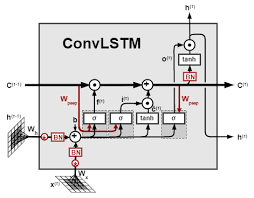

For video classification, this approach effectively captures the spatial relation in the individual frames and the temporal relation across the
different frames. As a result of this convolution structure, the ConvLSTM is capable of taking in 3-Dimensional input (width, height, num_of_channels)
whereas a simple LSTM only takes in 1-dimensional input hence an LSTM is incompatible for modeling Spatio-tempotal data on its own.
You can read the paper Convolutional LSTM Network: A Machine Learning Approach for Precipitation Nowcasting by Xingjian Shi (NIPS 2015) to learn more about this architecture.

Construct the Model :
To construct the model, we will use Keras ConvLSTM2D recurrent layers. The ConvLSTM2D layer also takes in the number of filters and kenel size required for applying the convolutional operations. The output of the layers is flattened in the end and is fed to the Dense layer with softmax
activation which outputs the probability of each action category.
We will also use maxPooling3D layers to reduce the dimensions of the frames and avoid unnecessary computations and Dropout layers to prevent oyeffltting the model on the data. The architecture is a simple one and has a small number of trainable parameters. This is because we are only dealing with a small subset of the dataset which does not require a large-scale model.

In [ ]:
def convlstm_model():
  # creating model in the function.

  model = Sequential()
  # Using Sequential to construct the model.

  # Model Architecture.
  #################
  model.add(ConvLSTM2D(filters = 4, kernel_size = (3, 3), activation = 'tanh',
                       data_format = "channels_last", recurrent_dropout=0.2,
                       return_sequences=True, input_shape = (SEQUENCE_LENGTH, IMAGE_HEIGHT, IMAGE_WIDTH, 3)))
  # Each layer has 4 filters of kernel size 3*3 slides over input data.
  # "channels_last" means the input shape is (batch_size, depth, height, width, channels). The other option is "channels_first", which means (batch_size, channels, depth, height, width).
  # recurrent_dropout, prevent overfittig and use in RNN, here LSTM is from RNN.
  # tanh, is for non linear dataset.

  model.add(MaxPooling3D(pool_size = (1, 2, 2), padding = "same",
                         data_format = "channels_last"))
  # Using MaxPooling, selets max outof poolsize window.
  # pool_size (Depth, Height, Width), pooling window size.
  # padding keep the size same by adding 0 if want to increase the size.

  model.add(TimeDistributed(Dropout(0.2)))
  # Using TimeDistributed(), whenever we apply something for perticular.
  # like here. Applying this for perticular selected frames from the video.
  # This is normal Dropout, Drop random 20% neurons.


  model.add(ConvLSTM2D(filters = 8, kernel_size = (3, 3), activation = 'tanh',
                       recurrent_dropout=0.2, return_sequences=True))
  model.add(MaxPooling3D(pool_size = (1, 2, 2), padding = "same",
                         data_format = "channels_last"))
  model.add(TimeDistributed(Dropout(0.2)))


  model.add(ConvLSTM2D(filters = 14, kernel_size = (3, 3), activation = 'tanh',
                       recurrent_dropout=0.2, return_sequences=True))
  model.add(MaxPooling3D(pool_size = (1, 2, 2), padding = "same",
                         data_format = "channels_last"))
  model.add(TimeDistributed(Dropout(0.2)))


  model.add(ConvLSTM2D(filters = 16, kernel_size = (3, 3), activation = 'tanh',
                       recurrent_dropout=0.2, return_sequences=True))
  model.add(MaxPooling3D(pool_size = (1, 2, 2), padding = "same",
                         data_format = "channels_last"))


  model.add(Flatten())
  # Flattening the model from 3D to 1D.
  # simply multipy all the parameters.
  # Flattening is Important, always before using Dense layers.

  model.add(Dense(len(CLASSES_LIST), activation = "softmax"))
  # Last layer always Dense and with activation softmax or sigmoid most of the time. but it depends.
  # We use softmax here because it is multiclass labeled. ( Sigmoid for binary )
  # Dense only allow 1D hence did Flattening.

  ###############

  model.summary()
  # Displays model summary.

  return model
  # Return the constructed convlstm model.



In [ ]:
convlstm_model = convlstm_model()
# Created convlstm model.
# Saved the function in the variable. so Easy to use later.

print("Model Created Successfully !!")

  super().__init__(**kwargs)



Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv_lstm2d (ConvLSTM2D)             │ (None, 20, 62, 62, 4)       │           1,024 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling3d (MaxPooling3D)         │ (None, 20, 31, 31, 4)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ time_distributed (TimeDistributed)   │ (None, 20, 31, 31, 4)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv_lstm2d_1 (ConvLSTM2D)           │ (None, 20, 29, 29, 8)       │           3,488 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling3d_1 (MaxPooling3D)       │ (None, 20, 15, 15, 8)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ time_distributed_1 (TimeDistributed) │ (None, 20, 15, 15, 8)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv_lstm2d_2 (ConvLSTM2D)           │ (None, 20, 13, 13, 14)      │          11,144 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling3d_2 (MaxPooling3D)       │ (None, 20, 7, 7, 14)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ time_distributed_2 (TimeDistributed) │ (None, 20, 7, 7, 14)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv_lstm2d_3 (ConvLSTM2D)           │ (None, 20, 5, 5, 16)        │          17,344 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling3d_3 (MaxPooling3D)       │ (None, 20, 3, 3, 16)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 2880)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 4)                   │          11,524 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 44,524 (173.92 KB)

 Trainable params: 44,524 (173.92 KB)

 Non-trainable params: 0 (0.00 B)

Model Created Successfully !!


Check ModelS Structure:
Now we will use the plot_model() function, to check the structure of the constructed model, this is helpful while constructing a complex network and making that the network is created correctly.

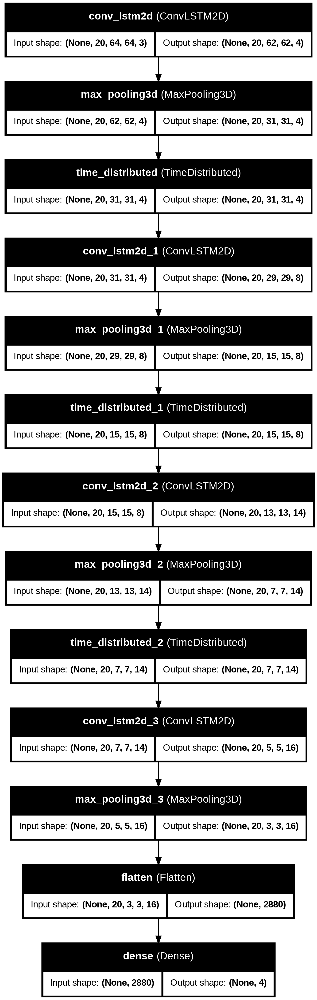

In [ ]:
plot_model(convlstm_model, to_file = "convlstm_model_structure_plot.png", show_shapes = True, show_layer_names = True)
# Plotting the structure of the model.
# Flow diagram type.

Compile & Train the Model:
Next, we will add an early stopping callback to prevent overfitting and start the training after compiling the model.

In [ ]:
early_stopping_callback = EarlyStopping(monitor = 'val_loss', patience = 10,
                                        mode = 'min', restore_best_weights = True)
# monitor, on which parameter we want to keep an eye. like accuracy, loss, cal_loss etc.
# patiencee, we wait this much epoch for given monitor. if it is constant it stoped.
# mode, It is min or max, for loss its min and accuracy max, coz we want to minmize the loss and maximize the accuracy.
# It restore the best weight on its own.
# We Use EarlyStopping becaus its computaionaly good, stop at best result epoch.

convlstm_model.compile(loss = "categorical_crossentropy", optimizer = "adam", metrics = ["accuracy"])
# Compiling model, Specifying loss, categorical_crossentropy for multilass.
# adam, as an optimizer. mostly used.
# metrics, To keep eye on. we can give more like mse and all.

convlstm_model_training_history = convlstm_model.fit(x = features_train, y = labels_train,validation_split=0.2,
                                               epochs = 50, batch_size = 5,
                                               callbacks = [early_stopping_callback])
# Training the model, on train data.
# epochs 50, How many times the forword-backword propogation happens.
# data goes in batch size so it takes less time, here batch of 5
# callback, is created - early_stopping. To stop at best parameters or epoch.

Epoch 1/50
61/61 ━━━━━━━━━━━━━━━━━━━━ 90s 1s/step - accuracy: 0.3274 - loss: 1.3427 - val_accuracy: 0.3553 - val_loss: 1.3526
Epoch 2/50
61/61 ━━━━━━━━━━━━━━━━━━━━ 83s 1s/step - accuracy: 0.5184 - loss: 1.1685 - val_accuracy: 0.4868 - val_loss: 1.2070
Epoch 3/50
61/61 ━━━━━━━━━━━━━━━━━━━━ 76s 1s/step - accuracy: 0.5818 - loss: 1.0556 - val_accuracy: 0.5395 - val_loss: 1.1917
Epoch 4/50
61/61 ━━━━━━━━━━━━━━━━━━━━ 86s 1s/step - accuracy: 0.6867 - loss: 0.8536 - val_accuracy: 0.5526 - val_loss: 1.1435
Epoch 5/50
61/61 ━━━━━━━━━━━━━━━━━━━━ 88s 1s/step - accuracy: 0.7246 - loss: 0.7333 - val_accuracy: 0.6053 - val_loss: 1.0978
Epoch 6/50
61/61 ━━━━━━━━━━━━━━━━━━━━ 147s 2s/step - accuracy: 0.7972 - loss: 0.6184 - val_accuracy: 0.6447 - val_loss: 1.0906
Epoch 7/50
61/61 ━━━━━━━━━━━━━━━━━━━━ 79s 1s/step - accuracy: 0.8444 - loss: 0.4964 - val_accuracy: 0.6316 - val_loss: 1.0980
Epoch 8/50
61/61 ━━━━━━━━━━━━━━━━━━━━ 79s 1s/step - accuracy: 0.8288 - loss: 0.4782 - val_accuracy: 0.6053 - val_loss

Evaluate the Trained Model
After training. we will evaluate the model on the test data.

In [ ]:
model_evaluation_history = convlstm_model.evaluate(features_test, labels_test)
# Evaluating the model on test data.
# Evaluation check how the data will work on the unseen data.

print("Model Accuracy : ", model_evaluation_history[1])

4/4 ━━━━━━━━━━━━━━━━━━━━ 8s 2s/step - accuracy: 0.6593 - loss: 0.9428
Model Accuracy :  0.658730149269104


Save the Model:
Now we will save the model to avoid training it from scratch every time we need the model.

In [ ]:
model_evaluation_loss, model_evaluation_accuracy = model_evaluation_history
# It will give the loss and accuracy from the model_evaluation_history

date_time_format = "%Y_%m_%d_%H_%M_%S"
# Deciding the date format to store.

current_date_time_dt = dt.datetime.now()
# It will give the current date and time using datetime Object.

current_date_time_string = dt.datetime.strftime(current_date_time_dt, date_time_format)
# strftime stands for "string format time".
# It is a method used to convert a datetime object to a string representation based on a specified format.
# Here we are converting currrent date in "%Y_%m_%d_%H_%M_%S this format and store in string.

model_file_name = f"convlstm_model__Date_Time_{current_date_time_string}__Loss_{model_evaluation_loss}__Accuracy_{model_evaluation_accuracy}.h5"
# Here we are giving meaningful name to the model while saving.
# It will be easy to nevigate the model through multiple saved models.

Plot Model's Loss & Accuracy Curves :
Now we will create a function plot_metric() to visualize the training and validation metrics. We already have separate metrics from our
training and validation steps so now we just have to visualize them.

In [ ]:
def plot_metric(model_training_history, metric_name_1, metric_name_2, plot_name):
  # This function will plot the metrics passed to it.
  # Args -
  # model_trainig_history : A history object containg the record of training and validation model.
  # metric_name_1 and metric_name_2  : Name of 1st and 2nd metric name that needs to be plotted in the graph, e.g loss or accuracy.
  # plot_name : The title of graph.

  metric_value_1 = model_training_history.history[metric_name_1]
  metric_value_2 = model_training_history.history[metric_name_2]
  # This will give the metric values using metric name as identifiers.

  epochs = range(len(metric_value_1))
  # Making a range for x-axis (horizontal plane)

  plt.plot(epochs, metric_value_1, "blue", label = metric_name_1)
  plt.plot(epochs, metric_value_2, "red", label = metric_name_2)
  # Plotting the graph

  plt.title(str(plot_name))
  # Adding title to the plot

  plt.legend()
  # This adds the small box in the corner or we can acdust the location of it.
  # It tells info about plot like meaning of different elements.

  plt.show()
  # Displaying the plot


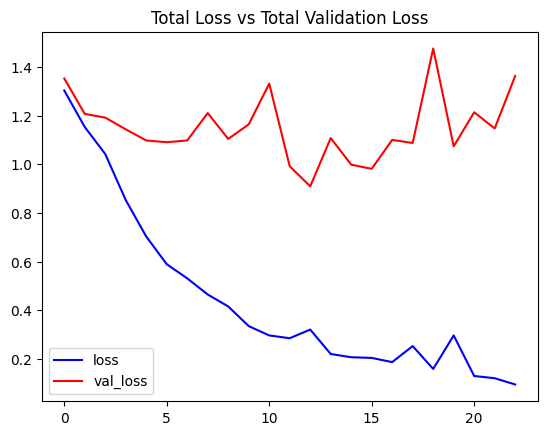

In [ ]:
plot_metric(convlstm_model_training_history, "loss", "val_loss", "Total Loss vs Total Validation Loss")
# Here we are visualising the training and validation loss metrics using created function.


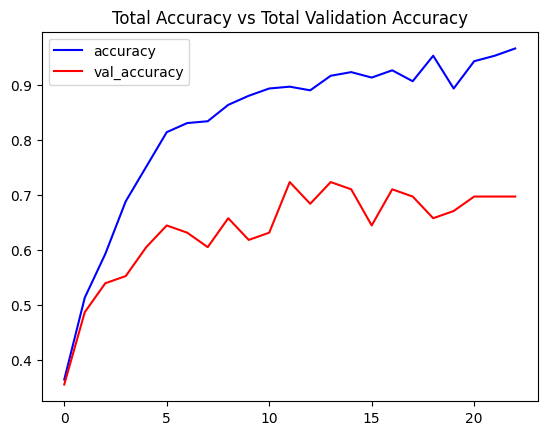

In [ ]:
plot_metric(convlstm_model_training_history, "accuracy", "val_accuracy", "Total Accuracy vs Total Validation Accuracy")
# Here we are visualising the training and validation accuracy metrics using created function.

**Implement the LRCN Approach.**


In this step, we will implement the LRCN Approach by combining Convolution and LSTM layers in a single model. Another similar approach can be to use a CNN model and LSTM model trained separately.
The CNN model can be used to extract spatial features from the frames in the video, and lot this purpose, a pretrained model can be used, that
can be fine-tuned for the problem. And the LSTM model can then use the features extracted by CNN, to predict the action being performed in
the video.

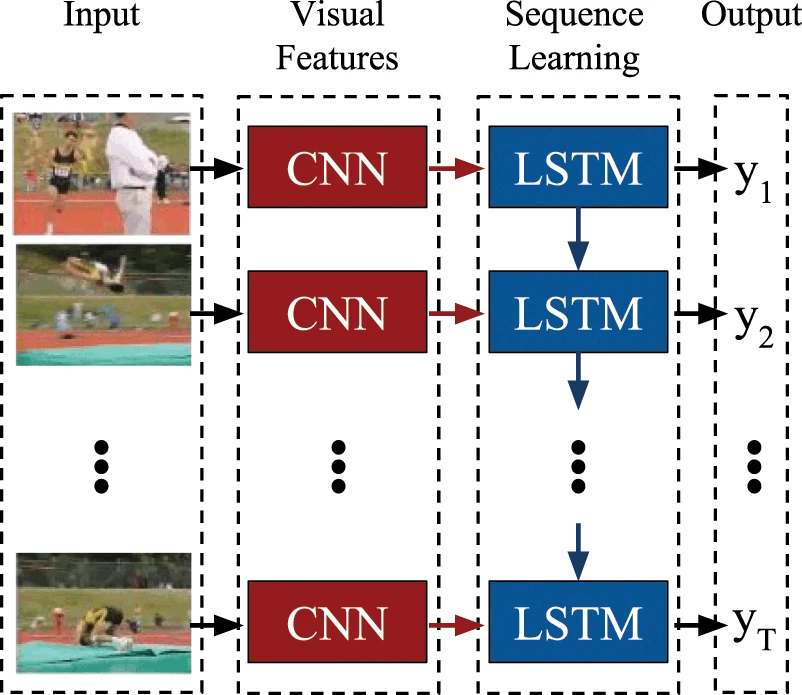

But here, we will implement another approach known as the Long-term Recurrent Convolutional Network (LRCN), which combines CNN and LSTM layers in a single model. The Convolutional layers are used for spatial feature extraction from the frames, and the extracted spatial features are fed to LSTM layer(s) at each time-steps for temporal sequence modeling. This way the network learns spatiotemporal features
directly in an end-to-end training. resulting in a robust model.
You can read the paper Long-term Recurrent Convolutional Network for Visual Recognition and Description by jeff Donahue (CVPR 2015), to learn more about this architecture.

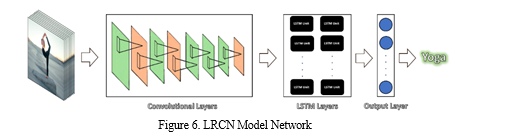

We will also use **TimeDistributed** wrapper layer. which allows applying the same layer to every frame of the video independently, So it makes a
layet (around which it is wrapped) capable of taking input of shape (no_of_frames, width, height, num_of_channels) if originally the layers
input shape was (width, height, num_of_channels) which is very beneficial as it allows to input the whole video into the model in a single
Shot.

Construct the Model:

TO implement our LRCN architecture, we Bill use time-distributed conv2D layers whiCh Will be followed by MaxPooling2D and Dropout layers. The feature extracted from the conv2D layers will be then flattened using the Flatten layer and will be fed to a LSTM layer. The Dense layer with softmax activation will then use the output from the LSTM layer to predict the action being performed.

In [ ]:
def create_LRCN_model():
  # We are making the LRCN model.
  # Combination of Conolutional and LSTM.

  model = Sequential()
  # Using Sequntial for model construction.

##########

  # Defining the model Architecture.
  model.add(TimeDistributed(Conv2D(16, (3, 3), padding = "same", activation = "relu"),
                            input_shape = (SEQUENCE_LENGTH, IMAGE_HEIGHT, IMAGE_WIDTH, 3)))
  # Here 16 is filters, 3*3 is kernal size.
  # input_shape This specifies the shape of the input data, where SEQUENCE_LENGTH is the number of frames, IMAGE_HEIGHT and IMAGE_WIDTH are the dimensions of each frame, and 3 represents the RGB color channels.
  model.add(TimeDistributed(MaxPooling2D((4, 4))))
  model.add(TimeDistributed(Dropout(0.25)))

  model.add(TimeDistributed(Conv2D(32, (3, 3), padding = "same", activation = "relu")))
  model.add(TimeDistributed(MaxPooling2D((4, 4))))
  model.add(TimeDistributed(Dropout(0.25)))

  model.add(TimeDistributed(Conv2D(64, (3, 3), padding = "same", activation = "relu")))
  model.add(TimeDistributed(MaxPooling2D((2, 2))))
  model.add(TimeDistributed(Dropout(0.25)))

  model.add(TimeDistributed(Conv2D(64, (3, 3), padding = "same", activation = "relu")))
  model.add(TimeDistributed(MaxPooling2D((2, 2))))

  model.add(TimeDistributed(Flatten()))
  # Flattening the layers in 1D because later for Dense it allows 1D.

  model.add(LSTM(32))
  # This is our LSTM layer.

  model.add(Dense(len(CLASSES_LIST), activation = "softmax"))
  # This is final Dense layer. with softmax, because it is multiclass.

###########

  model.summary()
  # It displays the summary.

  return model
  # Return the constructed LRCN model.

In [ ]:
LRCN_model = create_LRCN_model()
# Construct the required LRCN model.

print("Model Created Successfully !!")
# Displays the success message.

  super().__init__(**kwargs)



Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ time_distributed (TimeDistributed)   │ (None, 20, 64, 64, 16)      │             448 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ time_distributed_1 (TimeDistributed) │ (None, 20, 16, 16, 16)      │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ time_distributed_2 (TimeDistributed) │ (None, 20, 16, 16, 16)      │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ time_distributed_3 (TimeDistributed) │ (None, 20, 16, 16, 32)      │           4,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ time_distributed_4 (TimeDistributed) │ (None, 20, 4, 4, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ time_distributed_5 (TimeDistributed) │ (None, 20, 4, 4, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ time_distributed_6 (TimeDistributed) │ (None, 20, 4, 4, 64)        │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ time_distributed_7 (TimeDistributed) │ (None, 20, 2, 2, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ time_distributed_8 (TimeDistributed) │ (None, 20, 2, 2, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ time_distributed_9 (TimeDistributed) │ (None, 20, 2, 2, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ time_distributed_10                  │ (None, 20, 1, 1, 64)        │               0 │
│ (TimeDistributed)                    │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ time_distributed_11                  │ (None, 20, 64)              │               0 │
│ (TimeDistributed)                    │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm (LSTM)                          │ (None, 32)                  │          12,416 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 4)                   │             132 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 73,060 (285.39 KB)

 Trainable params: 73,060 (285.39 KB)

 Non-trainable params: 0 (0.00 B)

Model Created Successfully !!


Check Model Structure :
Now we will use the plot_model() function to check the structure of the constructed LRCN model. As we had checked for the previous model.

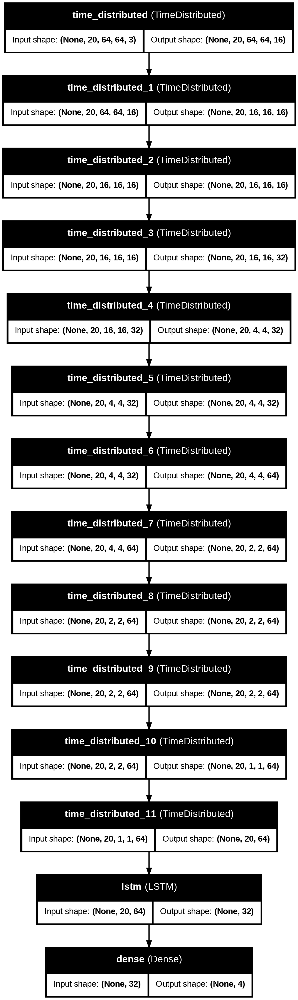

In [ ]:
plot_model(LRCN_model, to_file = "LRCN_model_structure_plot.png", show_shapes = True, show_layer_names = True)
# Plot the structure of the created model.
# flow chart like diagram.

Compile & Train the Model:

After checking the structure, we will compile and start training the model.

In [ ]:
early_stopping_callback = EarlyStopping(monitor = "val_loss", patience = 15, mode = "min", restore_best_weights = True)
# Creating Early stopping so model can stop at the best epoch and least val_loss.
# And it will wait for the 15 epochs to check the val_loss changeness.

LRCN_model.compile(loss = "categorical_crossentropy", optimizer = "Adam", metrics = ["accuracy"])
# Compiing the model, specifying the loss function, optimizer and metrics to the model.

LRCN_model_training_history = LRCN_model.fit(x = features_train, y = labels_train, epochs = 70, batch_size = 5,
                                         shuffle = True, validation_split = 0.2, callbacks = [early_stopping_callback])
# Training the model here.

Epoch 1/70
56/56 ━━━━━━━━━━━━━━━━━━━━ 23s 110ms/step - accuracy: 0.2699 - loss: 1.3978 - val_accuracy: 0.2571 - val_loss: 1.3844
Epoch 2/70
56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 49ms/step - accuracy: 0.3066 - loss: 1.3807 - val_accuracy: 0.4286 - val_loss: 1.3587
Epoch 3/70
56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 54ms/step - accuracy: 0.4340 - loss: 1.2747 - val_accuracy: 0.5000 - val_loss: 1.1392
Epoch 4/70
56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 50ms/step - accuracy: 0.5003 - loss: 1.1118 - val_accuracy: 0.6286 - val_loss: 1.0980
Epoch 5/70
56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 51ms/step - accuracy: 0.4909 - loss: 1.1104 - val_accuracy: 0.5429 - val_loss: 1.0550
Epoch 6/70
56/56 ━━━━━━━━━━━━━━━━━━━━ 4s 65ms/step - accuracy: 0.5781 - loss: 0.8859 - val_accuracy: 0.5714 - val_loss: 0.9028
Epoch 7/70
56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 51ms/step - accuracy: 0.7142 - loss: 0.7064 - val_accuracy: 0.5857 - val_loss: 0.9862
Epoch 8/70
56/56 ━━━━━━━━━━━━━━━━━━━━ 3s 48ms/step - accuracy: 0.7548 - loss: 0.6565 - val_accuracy: 0.6286 -

Evaluating the trained Model.

As done for the previous one, we will evaluate the LRCN model on the test set.

In [ ]:
model_evaluation_history = LRCN_model.evaluate(features_test, labels_test)
# Evaluate the train model.

4/4 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.9427 - loss: 0.3427


Save the model.

After that, we will save the model for future uses using the smae technique we had used for the previous model.

In [ ]:
model_evaluation_loss, model_evaluation_accuracy = model_evaluation_history
# It will give the loss and accuracy from the model_evaluation_history

date_time_format = "%Y_%m_%d_%H_%M_%S"
# Deciding the date format to store.

current_date_time_dt = dt.datetime.now()
# It will give the current date and time using datetime Object.

current_date_time_string = dt.datetime.strftime(current_date_time_dt, date_time_format)
# strftime stands for "string format time".
# It is a method used to convert a datetime object to a string representation based on a specified format.
# Here we are converting currrent date in "%Y_%m_%d_%H_%M_%S this format and store in string.

model_file_name = f"LRCN_model__Date_Time_{current_date_time_string}__Loss_{model_evaluation_loss}__Accuracy_{model_evaluation_accuracy}.h5"
# Here we are giving meaningful name to the model while saving.
# It will be easy to nevigate the model through multiple saved models.

LRCN_model.save(model_file_name)

Plot Model's Loss & Accuracy Curves.

Now we will utilize the function plot_metric() we had created above to visualize the trainig and validation metrics of this model.

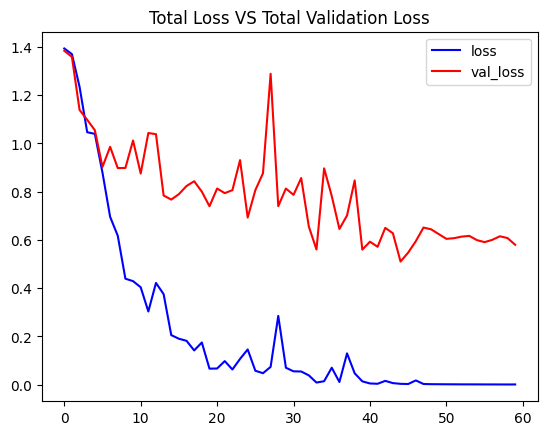

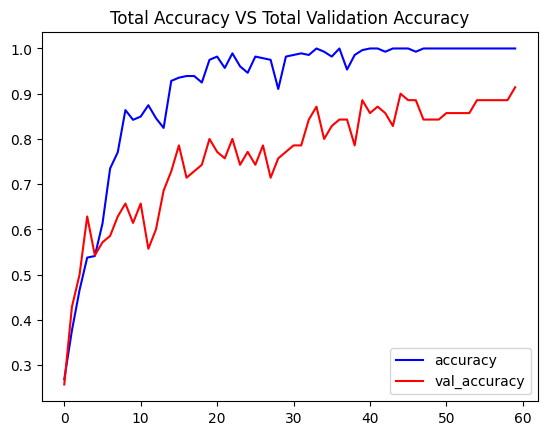

In [ ]:
plot_metric(LRCN_model_training_history, 'loss', 'val_loss', 'Total Loss VS Total Validation Loss')
# Visualize the trainig and validation loss metrics.

plot_metric(LRCN_model_training_history, 'accuracy', 'val_accuracy', 'Total Accuracy VS Total Validation Accuracy')
# Visualize the trainig and validation accuracy metrics.

plt.show()

**Test the Best Perfroming Model on YouTube videos**

From the results, it seems that the LRCN model performed significantly well for a small number of classes. so in this step, we will put the LRCN
model to test on some youtube videos

Create a Function to Download YouTube Videos:
We will create a function download_youtube_videos() to download the YouTube videos first using pafy library. The library only requires a URL
to a video to download it along with its associated metadata like the title of the video.

In [ ]:
# # OLD WAY

# def download_youtube_videos(youtube_video_url, output_directory):
#   # This function downloads the youtube video, By giving URL and save to the location provided in the argument.

#   # Args : youtube_video_url - URL of the video
#   #        output_directory - Directory path to which video needs to be stored after downloading.
#   # Return : It return the title, Title of the downloaded video .

#   video = pafy.new(youtube_video_url)
#   print(f"video : {video}")
#   # Create the video object which contain useful information about the video.

#   title = video.title
#   print(f"title {title}")
#   # Retrive the title of the video.

#   video_best = video.getbest()
#   print(f"video_best : {video_best}")
#   # It take out best quality object for the video.

#   output_file_path = f"{output_directory}/{title}.mp4"
#   # Making the output file path.

#   video_best.download(filepath = output_file_path, quiet = True)
#   # Download the video and strore in the constructed path.

#   return title
#   # Return the video title.

In [ ]:
pip install -U yt-dlp


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 172.1/172.1 kB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 68.3 MB/s eta 0:00:00


In [ ]:
import os
from yt_dlp import YoutubeDL

def download_youtube_videos(youtube_video_url, output_directory):
    # This function downloads the youtube video, By giving URL and saves to the location provided in the argument.

    # Args : youtube_video_url - URL of the video
    #        output_directory - Directory path to which video needs to be stored after downloading.
    # Return : It returns the title, Title of the downloaded video .

    # Set the options for yt-dlp
    ydl_opts = {
        'outtmpl': os.path.join(output_directory, '%(title)s.%(ext)s'),  # Save video in the given output directory with title as filename
        'format': 'best',  # Download the best quality
    }

    with YoutubeDL(ydl_opts) as ydl:
        # Download the video
        info_dict = ydl.extract_info(youtube_video_url, download=True)
        title = info_dict.get('title', None)  # Get the title of the video

    return title

# Usage example:
test_videos_directory = "test_videos"
os.makedirs(test_videos_directory, exist_ok=True)  # Make a directory if it doesn't exist

# video_title = download_youtube_videos("https://www.youtube.com/watch?v=8u0qjmHIOcE", test_videos_directory)
video_title = download_youtube_videos("https://youtube.com/shorts/h9TjbiiesHI?si=qPGYE23uroEfYppw", test_videos_directory)
# video_title = download_youtube_videos("https://youtu.be/WDIpL0pjun0?si=yUSZ1nNGp4Bauqxp", test_videos_directory)
# Download the YouTube video
# sanitized_title = video_title.replace("|", "_")
# input_video_file_path = f"{test_videos_directory}/{sanitized_title}-Output-SeqLen{SEQUENCE_LENGTH}.MP4"

input_video_file_path = f"{test_videos_directory}/{video_title}.mp4"  # Path to the downloaded video

print(f"Downloaded video saved to: {input_video_file_path}")


[youtube] Extracting URL: https://youtube.com/shorts/h9TjbiiesHI?si=qPGYE23uroEfYppw
[youtube] h9TjbiiesHI: Downloading webpage
[youtube] h9TjbiiesHI: Downloading ios player API JSON
[youtube] h9TjbiiesHI: Downloading tv player API JSON
[youtube] h9TjbiiesHI: Downloading m3u8 information
[info] h9TjbiiesHI: Downloading 1 format(s): 18
[download] Destination: test_videos/The Right Way to Walk Your Dog 🐕 #dog #cesarmillan #dogtraining.mp4
[download] 100% of    4.33MiB in 00:00:00 at 7.25MiB/s   
Downloaded video saved to: test_videos/The Right Way to Walk Your Dog 🐕 #dog #cesarmillan #dogtraining.mp4


Download a Test Video:
Now we will utilize the function download_youtube_videos() created above to download a youtube video on which the LRCN model will be tested.

In [ ]:
# # OLD WAY

# test_videos_directory = "test_videos"
# os.makedirs(test_videos_directory, exist_ok = True)
# # Make a directory if it does not exist, keeping exist_ok True

# video_title = download_youtube_videos("https://youtu.be/3BUsb1Ioge8?si=jkB0W4pvsVYyoH4s", test_videos_directory)
# # Download a youtube video

# input_video_file_path = f"{test_videos_directory}/{video_title}.mp4"

In [ ]:
def predict_on_video(video_file_path, output_file_path, SEQUENCE_LENGTH):
  # This function will perform action recognition on a video using the LRCN model.
  # Arg: Video_file_path - The path of the video stored in the disk on which the action recognition is to be performed.
  #      output_file_path - The path where output video will be save with predicted action written over it.
  #      SEQUENCE_LENGTH - This is the fix number of frames of video passed to the model. e.g here 20.

  video_reader = cv2.VideoCapture(video_file_path)
  # By using VideoCapture Object read the video file.

  original_video_width = int(video_reader.get(cv2.CAP_PROP_FRAME_WIDTH))
  original_video_height = int(video_reader.get(cv2.CAP_PROP_FRAME_HEIGHT))
  # It gives the width and height of the video.

  video_writer = cv2.VideoWriter(output_file_path, cv2.VideoWriter_fourcc(*'MP4V'),
                                 video_reader.get(cv2.CAP_PROP_FPS), (original_video_width, original_video_height))
  print(f"video_writer : {video_writer}")
  # By using VideoWriter Object, to store the output video in the disk.

  frames_queue = deque(maxlen = SEQUENCE_LENGTH)
  print(f"frames_queue : {frames_queue}")
  # Declare a queue to store video frame.

  predicted_class_name = ''
  # This variable store the predicted actionn being performed in the video.

  while video_reader.isOpened():
    # Iterate untill video is access successfully.

    ok, frame = video_reader.read()
    print(ok, frame)
    # Read the frame

    if not ok:
      break
    # Check if frame is not read properly then break the loop.

    resized_frame = cv2.resize(frame, (IMAGE_HEIGHT, IMAGE_WIDTH))
    print(resized_frame)
    # resizing the frame to fixed dimention.

    normalized_frame = resized_frame / 255
    print(normalized_frame)
    # Normalizing the resized frame by deviding 255, so each pixel value lies between 0 to 1.

    frames_queue.append(normalized_frame)
    # Adding pre-processed frame into the frames list.

    if len(frames_queue) == SEQUENCE_LENGTH:
      # Check if the number of frames in the queue are equal to the fixed sequence length.

      predicted_labels_probabilities = LRCN_model.predict(np.expand_dims(frames_queue, axis = 0))[0]
      # Pass the normalized frames to the model and get he predicted probabilities.

      predicted_label = np.argmax(predicted_labels_probabilities)
      # Get the index of class with highest probability.

      predicted_class_name = CLASSES_LIST[predicted_label]
      # Get the class name using retrieved index.

    cv2.putText(frame, predicted_class_name, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)
    # Wrute predicted class name on top of the frame.

    video_writer.write(frame)
    # Write the framea into the disk using the VideoWriter Object.

  video_reader.release()
  video_writer.release()
  # Releaset the VideoCpature and VideoWriter Objects.



Perform Action Recognition on the Test Video.
Now we will utilize the function predict_on_video() created above to perform action recognition on the test video we had downloaded using
the function download_youtube_video() and display the output video with the predicted action overlayed on it.

In [ ]:
# sanitized_title = video_title.replace("|", "_")
# output_video_file_path = f"{test_videos_directory}/{sanitized_title}-Output-SeqLen{SEQUENCE_LENGTH}.MP4"
output_video_file_path = f"{test_videos_directory}/{video_title}-Output-SeqLen{SEQUENCE_LENGTH}.MP4"

print(output_video_file_path)
# Construct the output video path.

predict_on_video(input_video_file_path, output_video_file_path, SEQUENCE_LENGTH)
# perform action recognition on the test video.

# VideoFileClip(output_video_file_path, audio = False, target_resolution = (300, None)).ipython_display()
# Display the output video.
VideoFileClip(output_video_file_path, audio=False, target_resolution=(300, None)).ipython_display(maxduration=120)



Streaming output truncated to the last 5000 lines.
  [ 52  47  48]
  ...
  [167 171 173]
  [167 171 173]
  [167 171 173]]

 [[ 52  47  48]
  [ 52  47  48]
  [ 52  47  48]
  ...
  [167 171 173]
  [167 171 173]
  [167 171 173]]]
[[[ 59  83  80]
  [ 72  96  93]
  [ 72  89  87]
  ...
  [ 62  75  62]
  [181 188 176]
  [ 82  94  81]]

 [[ 55  79  76]
  [ 64  88  85]
  [122 139 136]
  ...
  [ 85  98  85]
  [105 117 104]
  [ 79  91  78]]

 [[ 54  78  75]
  [ 64  86  83]
  [ 60  81  78]
  ...
  [ 62  70  60]
  [ 74  82  72]
  [162 170 160]]

 ...

 [[ 55  50  51]
  [ 55  50  51]
  [ 48  43  44]
  ...
  [168 167 176]
  [169 169 176]
  [170 170 177]]

 [[ 54  49  50]
  [ 54  49  50]
  [ 50  45  46]
  ...
  [168 173 173]
  [167 172 172]
  [166 170 172]]

 [[ 52  47  48]
  [ 52  47  48]
  [ 51  46  47]
  ...
  [169 173 175]
  [168 172 174]
  [167 171 173]]]
[[[0.23137255 0.3254902  0.31372549]
  [0.28235294 0.37647059 0.36470588]
  [0.28235294 0.34901961 0.34117647]
  ...
  [0.24313725 0.29411765 0

Moviepy - Done !
Moviepy - video ready __temp__.mp4


In [ ]:
import os
from moviepy.editor import VideoFileClip
import cv2
import numpy as np
from collections import deque

def predict_on_video(video_file_path, output_file_path, SEQUENCE_LENGTH):
    video_reader = cv2.VideoCapture(video_file_path)

    if not video_reader.isOpened():
        print("Error: Could not open video file.")
        return

    original_video_width = int(video_reader.get(cv2.CAP_PROP_FRAME_WIDTH))
    original_video_height = int(video_reader.get(cv2.CAP_PROP_FRAME_HEIGHT))

    video_writer = cv2.VideoWriter(output_file_path, cv2.VideoWriter_fourcc('M', 'J', 'P', 'G'),
                                   video_reader.get(cv2.CAP_PROP_FPS), (original_video_width, original_video_height))
    print(f"video_writer : {video_writer}")

    frames_queue = deque(maxlen=SEQUENCE_LENGTH)
    print(f"frames_queue : {frames_queue}")

    predicted_class_name = ''

    while video_reader.isOpened():
        ok, frame = video_reader.read()
        if not ok:
            break

        resized_frame = cv2.resize(frame, (224, 224))  # Assuming IMAGE_HEIGHT = IMAGE_WIDTH = 224
        normalized_frame = resized_frame / 255
        frames_queue.append(normalized_frame)

        if len(frames_queue) == SEQUENCE_LENGTH:
            predicted_labels_probabilities = LRCN_model.predict(np.expand_dims(frames_queue, axis=0))[0]
            predicted_label = np.argmax(predicted_labels_probabilities)
            predicted_class_name = CLASSES_LIST[predicted_label]

        cv2.putText(frame, predicted_class_name, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)
        video_writer.write(frame)

    video_reader.release()
    video_writer.release()

    if os.path.exists(output_file_path):
        print(f"Output video saved at: {output_file_path}")
    else:
        print("Error: Video file not saved.")

output_video_file_path = f"{test_videos_directory}/{video_title}-Output-SeqLen{SEQUENCE_LENGTH}.MP4"
predict_on_video(input_video_file_path, output_video_file_path, SEQUENCE_LENGTH)

# Check if the video was created and exists
if os.path.exists(output_video_file_path):
    VideoFileClip(output_video_file_path, audio=False, target_resolution=(300, None)).ipython_display()
else:
    print(f"Error: {output_video_file_path} could not be found.")
S

video_writer : < cv2.VideoWriter 0x7ad932eae6f0>
frames_queue : deque([], maxlen=20)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1

Create a Function To Perform a Single Prediction on Videos

Now let's create a function that will perform a single prediction for the complete videos. We will extract evenly distributed N (SEQUENCE_LENGTH)
frames from the entire video and pass them to the LRCN model. This approach is really useful when you are working with videos containing only
one activity as it saves unnecessary computations and time in that scenario.

In [34]:
def predict_single_action(video_file_path, SEQUENCE_LENGTH):
  # This function will perform single action recognition prediction on a video using LRCN model.
  # video_file_path - The path of the video stored in the disk on which the action recognition is to be performed.
  # SEQUENCE_LENGTH - fixed number of frames of that video can be passed to the model.

  video_reader = cv2.VideoCapture(video_file_path)
  # By using VideoCapture Object read the video file.

  original_video_width = int(video_reader.get(cv2.CAP_PROP_FRAME_WIDTH))
  original_video_height = int(video_reader.get(cv2.CAP_PROP_FRAME_HEIGHT))
  # It gives the width and height of the video.

  frames_list =[]
  # Making list to store video frames we will extract.

  predicted_class_name = ''
  # This variable will store the predicted action from the video.

  video_frames_count = int(video_reader.get(cv2.CAP_PROP_FRAME_COUNT))
  # Get the number of frames in the video.

  skip_frames_window = max(int(video_frames_count/SEQUENCE_LENGTH), 1)
  # Calculate the interval after which frames will be added to the list.

  for frame_counter in range(SEQUENCE_LENGTH):
    # This is to iterate through video frames.

    video_reader.set(cv2.CAP_PROP_POS_FRAMES, frame_counter * skip_frames_window)
    # Set the video reader to a specific frame based on the calculated frame index to control which frame to read next.

    success, frame = video_reader.read()
    print(f"Success : {success}, Frame : {frame}")
    # Reading the frame from the video.

    if not success:
      break
      # Breaking the loop if video frame is not successfuly read.

    resized_frame = cv2.resize(frame, (IMAGE_HEIGHT, IMAGE_WIDTH))
    # Resize the frame to the specified height and width.

    normalized_frame = resized_frame / 255
    # Normalizing the resized frame so it lies between the 0 to 1.
    # It is good for the computation.

    frames_list.append(normalized_frame)
    # Adding the final normalized frame in the frame_list

  predicted_labels_probabilities = LRCN_model.predict(np.expand_dims(frames_list, axis = 0))[0]
  # passing the pre-processed frames to the model and get the predicted probabilities.

  predicted_label = np.argmax(predicted_labels_probabilities)
  # Get the index of the class with highest probability.

  predicted_class_name = CLASSES_LIST[predicted_label]
  # Get the class name using the retrieved index.

  print(f"Action Predicted: {predicted_class_name}\nConfidence: {predicted_labels_probabilities[predicted_label]}")
  # Display the predicted action along with the predicion confidence.

  video_reader.release()
  # Release the VideoCapture object.


i

In [35]:
# video_title = download_youtube_videos('https://www.youtube.com/watch?v=8u0qjmHIOcE', test_videos_directory)
video_title = download_youtube_videos('https://youtube.com/shorts/h9TjbiiesHI?si=qPGYE23uroEfYppw', test_videos_directory)
                                      #  https://youtube.com/shorts/q8yFDvJB3xQ?si=eVT89CIfvlEpHs79
# Download Youtube video

input_video_file_path = f"{test_videos_directory}/{video_title}.mp4"
# construct the input youtube video path

predict_single_action(input_video_file_path, SEQUENCE_LENGTH)
# Perform single action recognition prediction on the downloaded video.

VideoFileClip(input_video_file_path, audio = False, target_resolution = (300, None)).ipython_display()
# Display the input video.



[youtube] Extracting URL: https://youtube.com/shorts/h9TjbiiesHI?si=qPGYE23uroEfYppw
[youtube] h9TjbiiesHI: Downloading webpage
[youtube] h9TjbiiesHI: Downloading ios player API JSON
[youtube] h9TjbiiesHI: Downloading tv player API JSON
[youtube] h9TjbiiesHI: Downloading m3u8 information
[info] h9TjbiiesHI: Downloading 1 format(s): 18
[download] test_videos/The Right Way to Walk Your Dog 🐕 #dog #cesarmillan #dogtraining.mp4 has already been downloaded
[download] 100% of    4.33MiB
Success : True, Frame : [[[249 234 230]
  [249 234 230]
  [249 234 230]
  ...
  [ 76  81  74]
  [ 73  78  71]
  [ 72  77  70]]

 [[249 234 230]
  [249 234 230]
  [249 234 230]
  ...
  [ 76  81  74]
  [ 73  78  71]
  [ 72  77  70]]

 [[249 234 230]
  [249 234 230]
  [249 234 230]
  ...
  [ 78  83  76]
  [ 76  81  74]
  [ 75  80  73]]

 ...

 [[ 28  22  25]
  [ 28  22  25]
  [ 28  22  25]
  ...
  [180 180 187]
  [180 180 187]
  [180 180 187]]

 [[ 28  22  25]
  [ 28  22  25]
  [ 28  22  25]
  ...
  [180 180 187

t:  99%|█████████▉| 1738/1755 [00:03<00:00, 448.39it/s, now=None]WARNING:py.warnings:/usr/local/lib/python3.10/dist-packages/moviepy/video/io/ffmpeg_reader.py:123: UserWarning: Warning: in file test_videos/The Right Way to Walk Your Dog 🐕 #dog #cesarmillan #dogtraining.mp4, 151200 bytes wanted but 0 bytes read,at frame 1753/1755, at time 58.49/58.54 sec. Using the last valid frame instead.
  warnings.warn("Warning: in file %s, "%(self.filename)+

  warnings.warn("Warning: in file %s, "%(self.filename)+

                                                                 

Moviepy - Done !
Moviepy - video ready __temp__.mp4
